## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

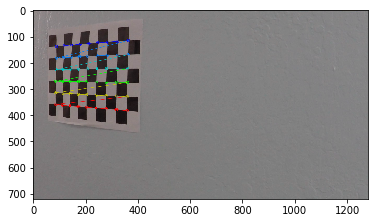

In [1]:
import numpy as np
import cv2
import glob
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle
import math
#from tracker import tracker
%matplotlib inline
#%matplotlib qt

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for idx,fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imwrite('../output_images/corners_found'+str(idx+1)+'.jpg', img)
        plt.imshow(img)
        #cv2.waitKey(500)

#cv2.destroyAllWindows()

## And so on and so forth...

In [2]:
img = cv2.imread('camera_cal/calibration1.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
# Read in the saved objpoints and imgpoints
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump(dist_pickle, open('calibration_pickle.p', 'wb'))

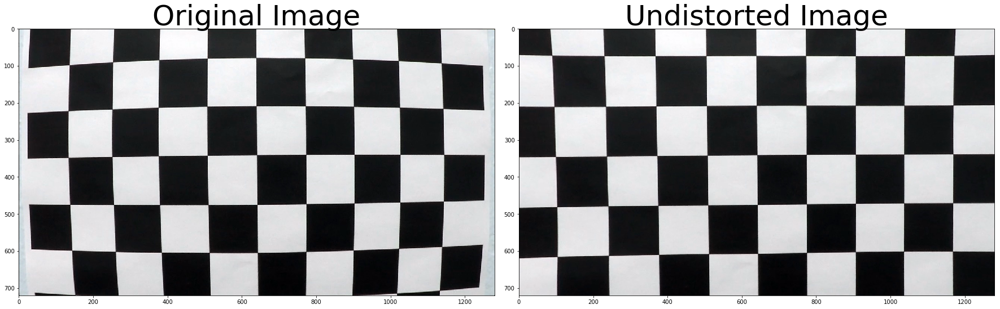

In [3]:
def cal_undistort(img, objpoints, imgpoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    return dst

undistorted = cal_undistort(img, objpoints, imgpoints)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undistorted)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

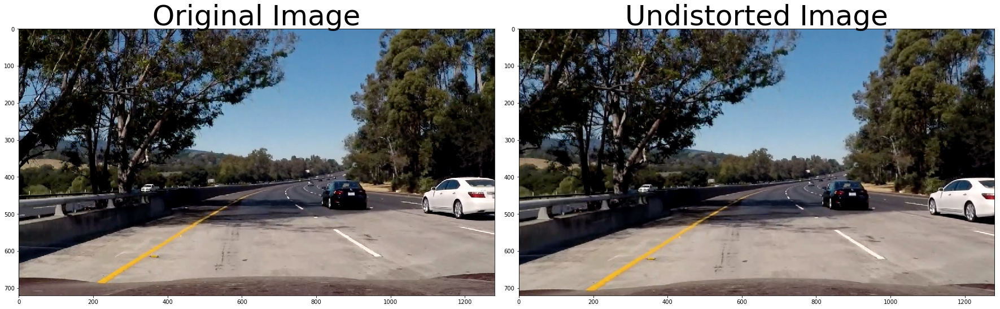

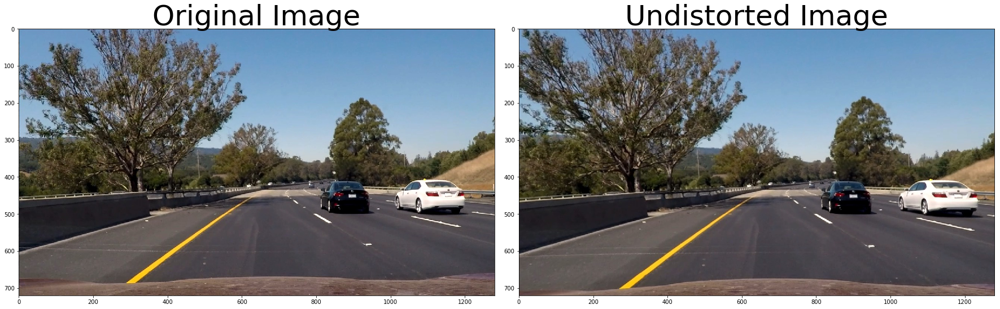

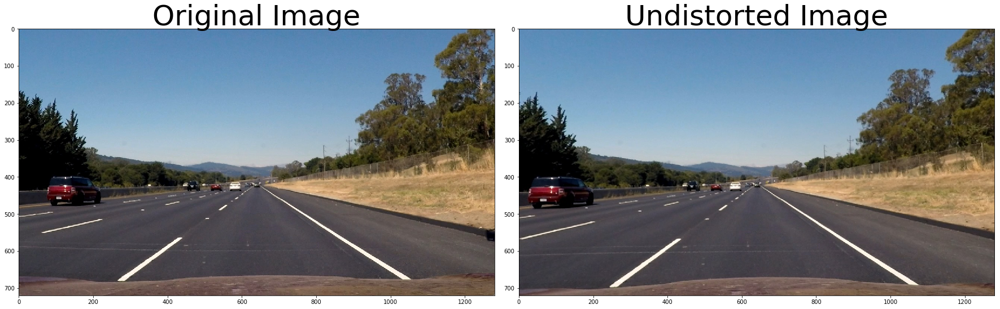

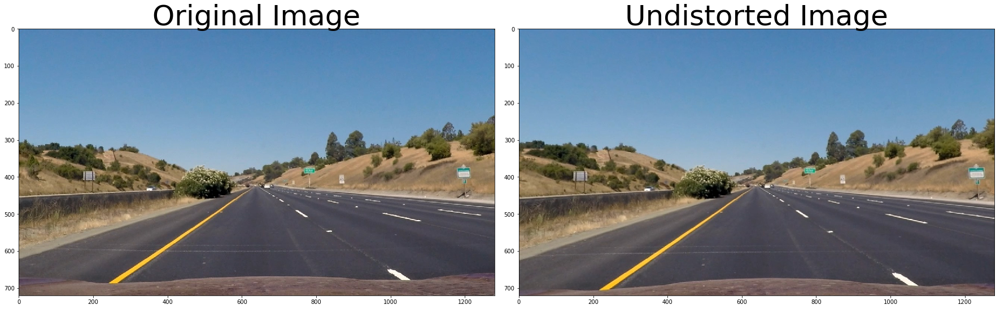

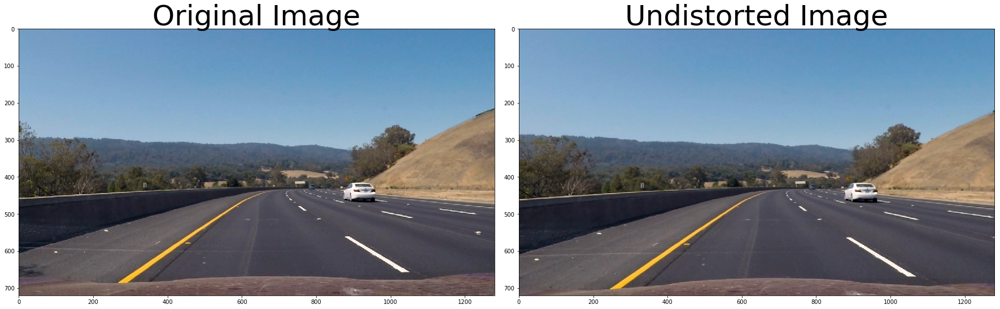

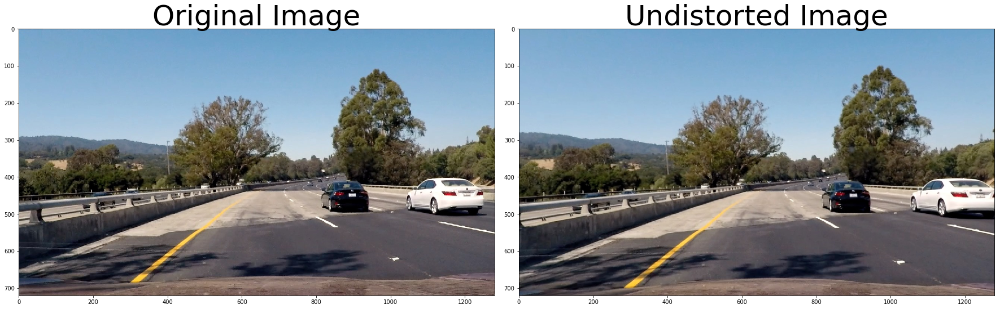

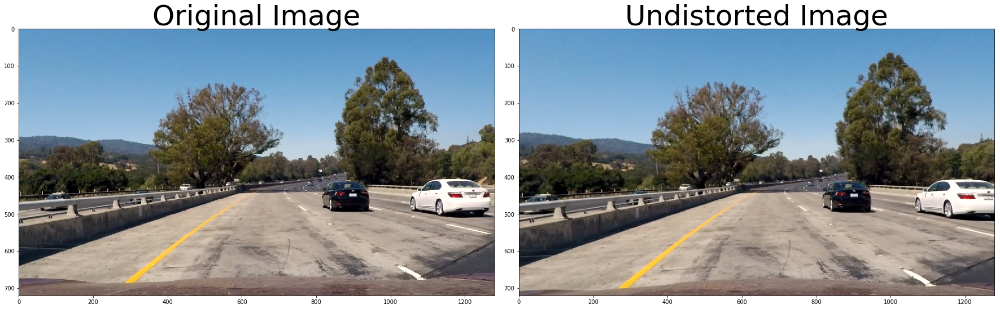

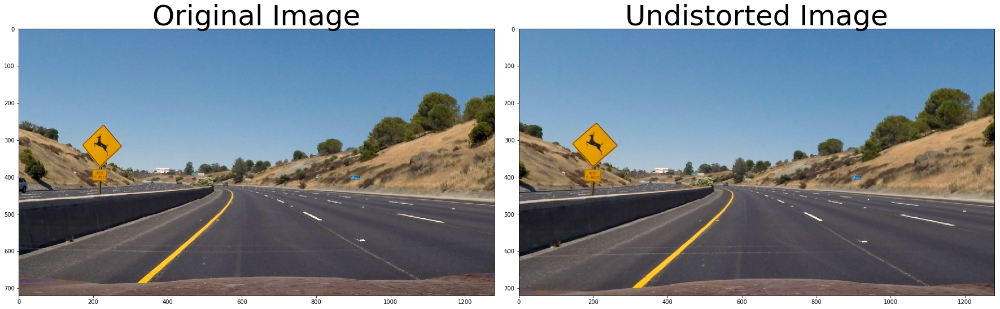

In [4]:
images = glob.glob('test_images/*.jpg')

for idx, file in enumerate(images):
    img = cv2.imread(file)
     
    undistorted = cal_undistort(img, objpoints, imgpoints)
    
    cv2.imwrite("output_images/undistorted_"+str(idx)+ '.jpg', undistorted)
    
    r, g, b = cv2.split(img)
    img= cv2.merge((b, g, r))
    
    r, g, b = cv2.split(undistorted)
    undistorted= cv2.merge((b, g, r))
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

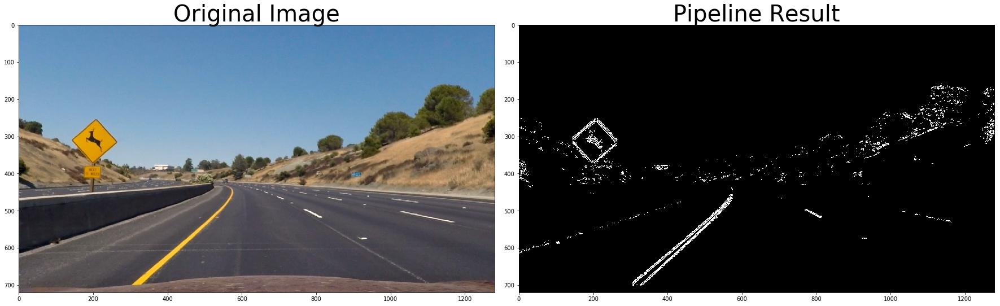

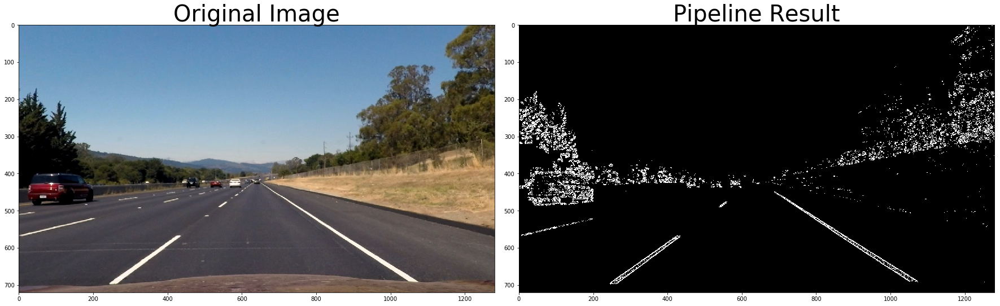

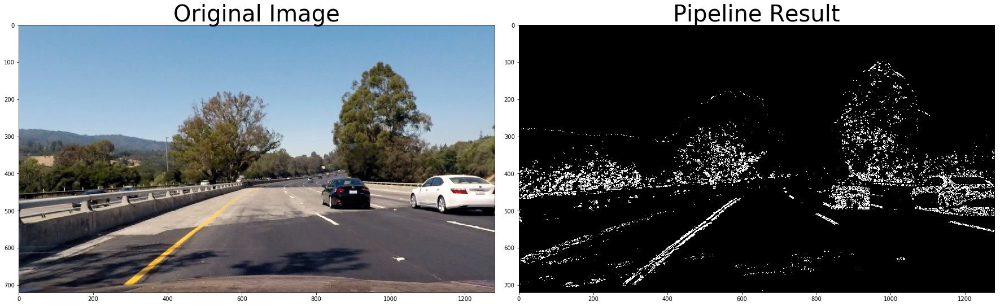

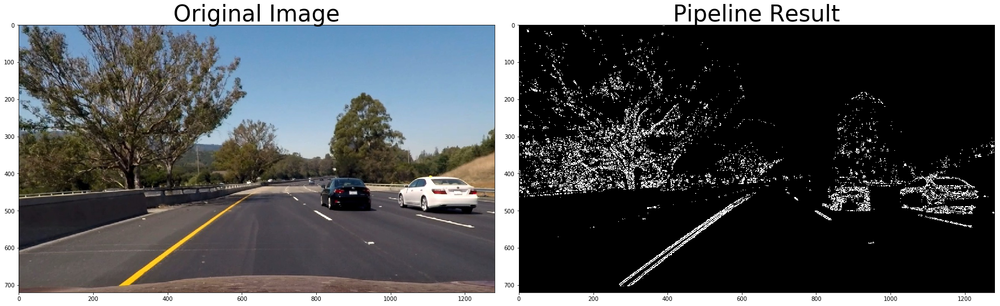

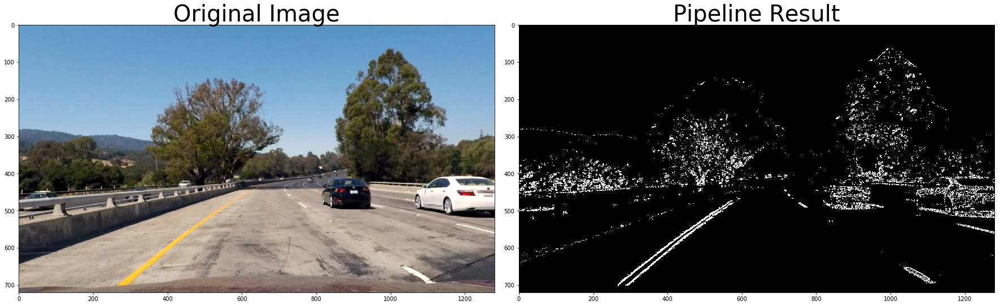

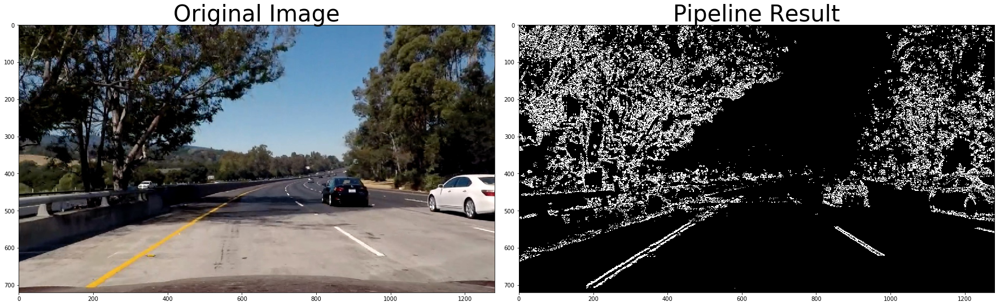

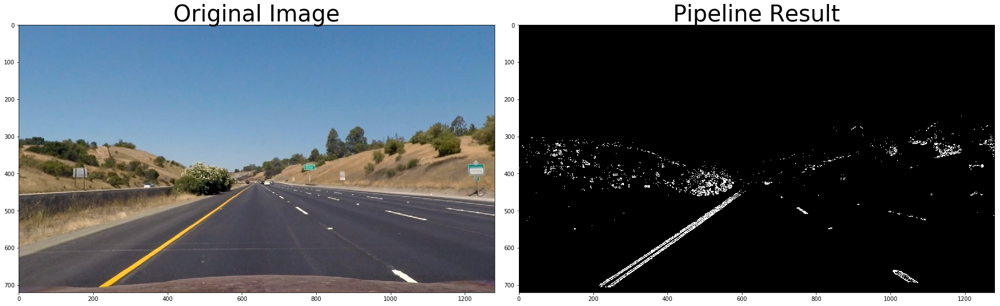

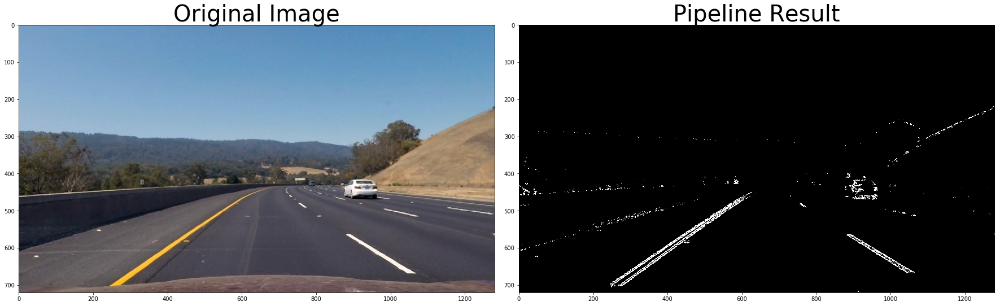

In [5]:
def pipeline(img, h_thresh=(150, 255), l_thresh=(20, 255),s_thresh=(100, 255), sx_thresh=(12, 255), sy_thresh=(25, 255)):
    img = np.copy(img)
    # Convert to HLS color space and separate the S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    
    # Sobel x
    sobelx = cv2.Sobel(s_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobelx = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Sobel y
    sobely = cv2.Sobel(s_channel, cv2.CV_64F, 0, 1) # Take the derivative in y
    abs_sobely = np.absolute(sobely) # Absolute y derivative to accentuate horizontal lines
    scaled_sobely = np.uint8(255*abs_sobely/np.max(abs_sobely))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobelx)
    sxbinary[(scaled_sobelx >= sx_thresh[0]) & (scaled_sobelx <= sx_thresh[1])] = 1
    
    # Threshold y gradient
    sybinary = np.zeros_like(scaled_sobely)
    sybinary[(scaled_sobely >= sy_thresh[0]) & (scaled_sobely <= sy_thresh[1])] = 1
    
    # Threshold color channel
    h_binary = np.zeros_like(h_channel)
    h_binary[(h_channel >= h_thresh[0]) & (h_channel <= h_thresh[1])] = 1
    
    # Threshold color channel
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh[0]) & (l_channel <= l_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Stack each channel
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, sybinary, h_binary, l_binary, s_binary)) * 255
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[((h_binary == 1) & (s_binary == 1) & (l_binary == 1)) | ((sxbinary == 1) & (sybinary == 1))] = 1
    return combined_binary
    
images = glob.glob('output_images/undistorted_*.jpg')

for idx, file in enumerate(images):
    img = cv2.imread(file)
    
    result = pipeline(img)
    
    cv2.imwrite("output_images/binary_"+str(idx)+ '.jpg', result)
    
    r, g, b = cv2.split(img)
    img= cv2.merge((b, g, r))
    
    #r, g, b = cv2.split(result)
    #result= cv2.merge((b, g, r))
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(result, cmap = 'gray')
    ax2.set_title('Pipeline Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

<IPython.core.display.Javascript object>


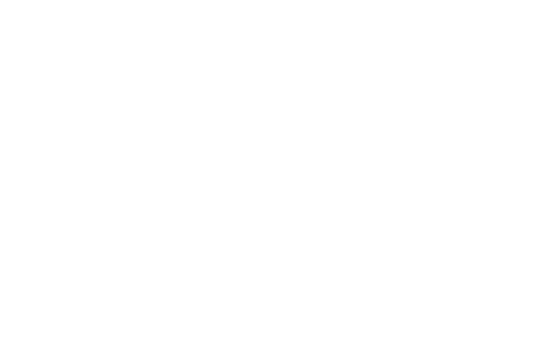

<IPython.core.display.Javascript object>


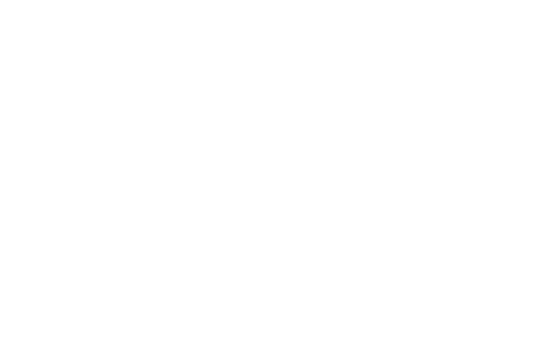

In [6]:
#I used this code tofind the exact x and y coordinates for the 4 points that lie on the lines 
image = mpimg.imread('test_images/straight_lines1.jpg')
%matplotlib notebook
plt.imshow(image)

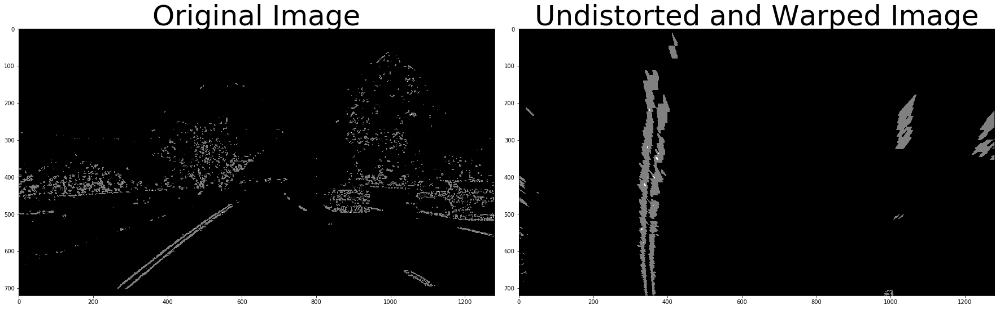

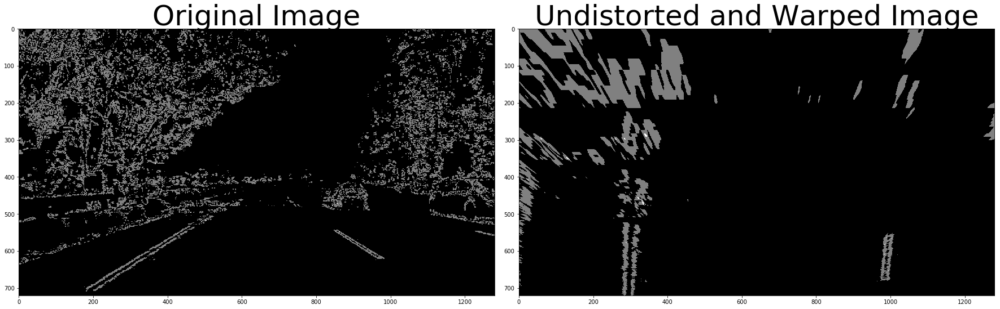

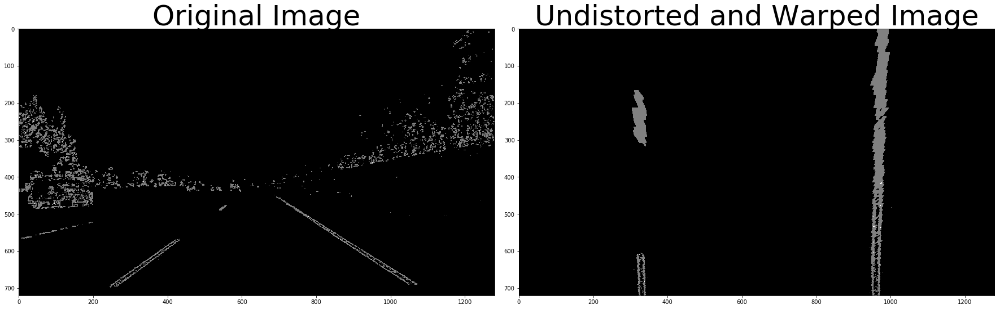

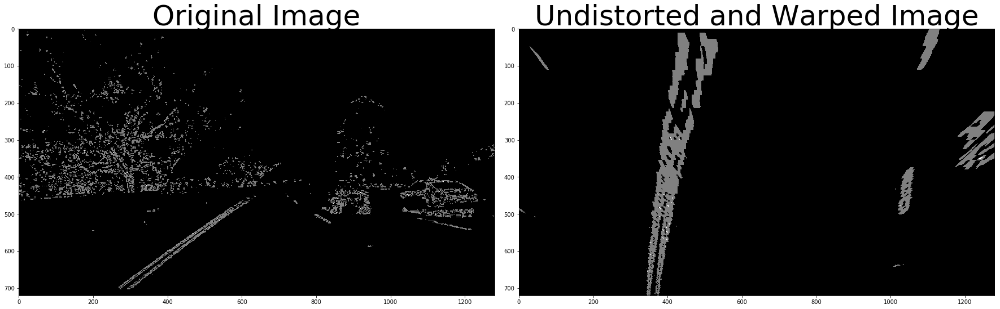

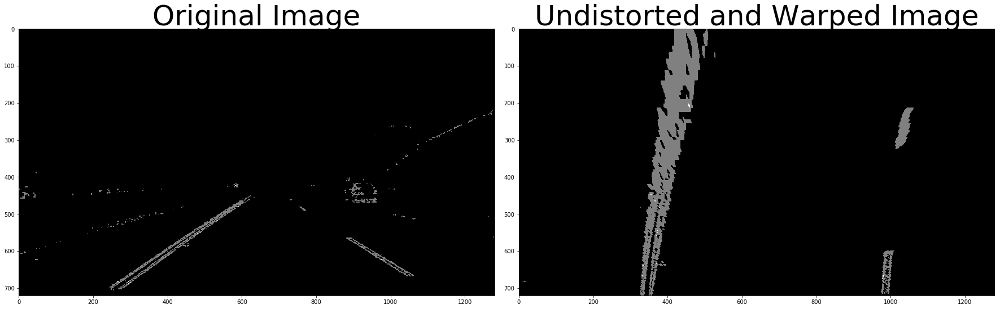

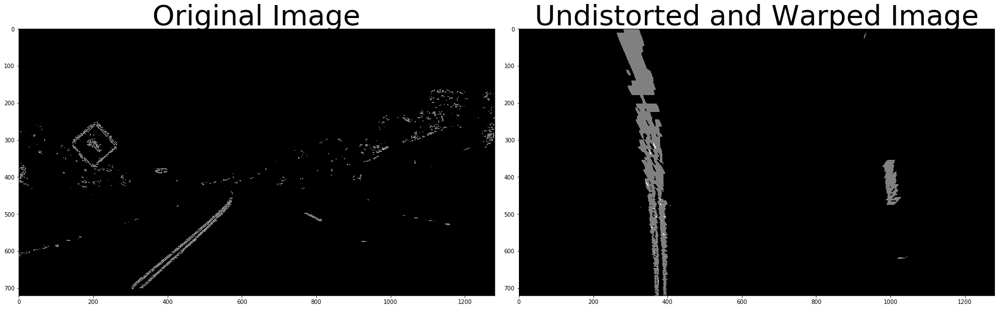

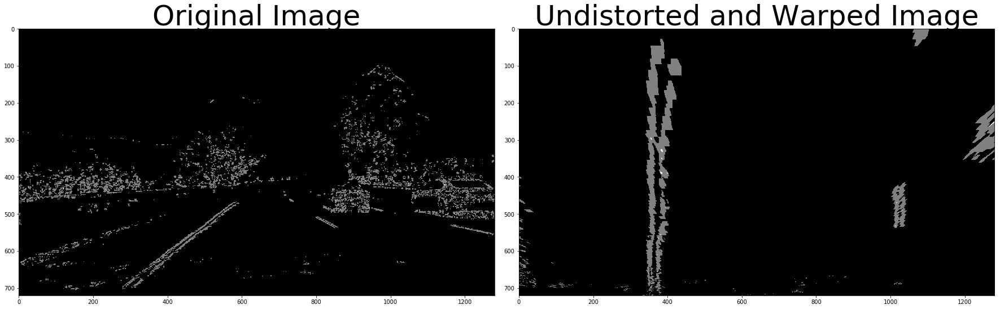

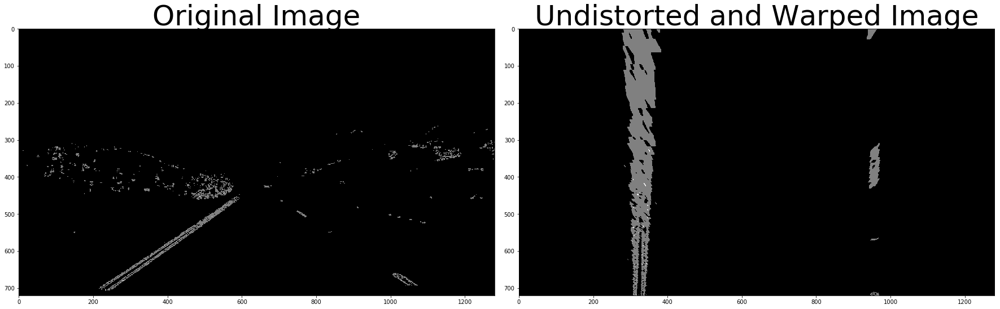

In [7]:
%matplotlib inline
def warp(img):
    
    # Grab the image shape
    img_size = (img.shape[1], img.shape[0])
    
    # For source points I'm grabbing the outer four detected corners         
    src = np.float32(
        [[573, 465], 
         [709, 465], 
         [1037, 674], 
         [270, 674]])
                 
    offset = img_size[0] * 0.25
                     
    dst = np.float32(
        [[offset, 0], 
         [img_size[0]-offset, 0], 
         [img_size[0]-offset, img_size[1]], 
         [offset, img_size[1]]])
    
    '''dst = np.float32(
        [[270, 0], 
         [1037, 0], 
         [1037, 720], 
         [270, 720]])'''
    
    # d) use cv2.getPerspectiveTransform() to get M, the transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # e) use cv2.warpPerspective() to warp your image to a top-down view
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped, M, Minv

files = glob.glob('output_images/binary*.jpg')

for idx, file in enumerate(files):
    img = mpimg.imread(file)
    
    warped_im, M, Minv = warp(img)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(img, cmap='gray')
    ax1.set_title('Original Image', fontsize=50)

    ax2.imshow(warped_im, cmap='gray')
    ax2.set_title('Undistorted and Warped Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    cv2.imwrite("output_images/undistorted_and_warped_"+str(idx)+'.jpg', warped_im)

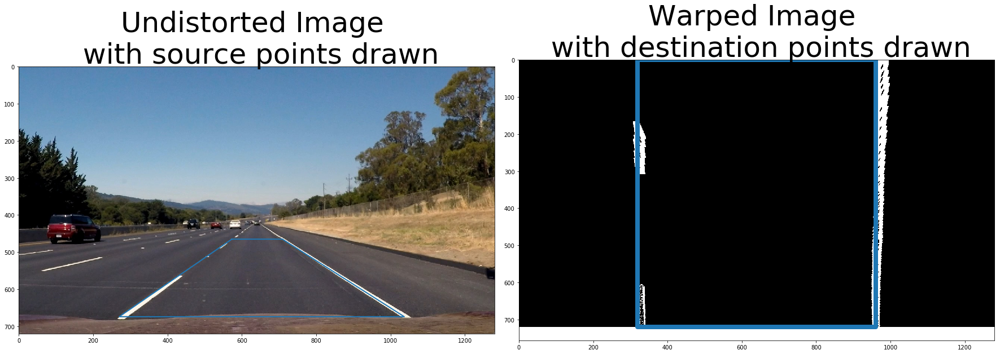

In [8]:
#This code cell shows the undistorted image with source points drawn on
#and the warped image with destination points drawn on
# Read in the image
image = mpimg.imread('test_images/straight_lines2.jpg')

undistorted = cal_undistort(image, objpoints, imgpoints)
undistorted = pipeline(undistorted)
warped_image, M, Minv = warp(undistorted)

image_size = (image.shape[1], image.shape[0])                 
offset = image_size[0] * 0.25

# Define the vertices of a trapezoidal mask.
top_left = [573, 465]
top_right = [709, 465]
bottom_right = [1037, 674]
bottom_left = [270, 674]
    
top_left2 = [offset, 0]
top_right2 = [image_size[0]-offset, 0]
bottom_right2 = [image_size[0]-offset, image_size[1]]
bottom_left2 = [offset, image_size[1]]
    
#top_left2 = [270, 0]
#top_right2 = [1037, 0]
#bottom_right2 = [1037, 720]
#bottom_left2 = [270, 720]

x = [top_left[0], top_right[0], bottom_right[0], bottom_left[0], top_left[0]]
y = [top_left[1], top_right[1], bottom_right[1], bottom_left[1], top_left[1]]

x2 = [top_left2[0], top_right2[0], bottom_right2[0], bottom_left2[0], top_left2[0]]
y2 = [top_left2[1], top_right2[1], bottom_right2[1], bottom_left2[1], top_left2[1]]

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

ax1.imshow(image)
ax1.plot(x,y, lw=2)
ax1.set_title('Undistorted Image \n with source points drawn', fontsize=50)

ax2.imshow(warped_image, cmap = 'gray')
ax2.plot(x2,y2, lw=8)
ax2.set_title('Warped Image \n with destination points drawn', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

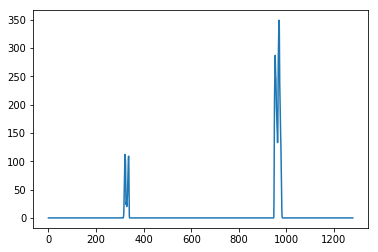

In [9]:
def hist(img):
    # TO-DO: Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car
    bottom_half = img[img.shape[0]//2:,:]

    # TO-DO: Sum across image pixels vertically - make sure to set `axis`
    # i.e. the highest areas of vertical lines should be larger values
    histogram = np.sum(bottom_half, axis=0)
    
    return histogram

# Create histogram of image binary activations
histogram = hist(warped_image)

# Visualize the resulting histogram
plt.plot(histogram)

In [10]:
#This cell calculates the difference(distance) in pixels between the left and right lanes
histogram = np.sum(warped_image[warped_image.shape[0]//2:,:], axis=0)
midpoint = np.int(histogram.shape[0]//2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint
print(rightx_base - leftx_base)

647


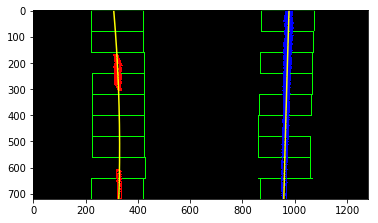

In [11]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return left_fitx, right_fitx, ploty, out_img

#leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)
left_fitx, right_fitx, ploty, out_img = fit_polynomial(warped_image)

plt.imshow(out_img)

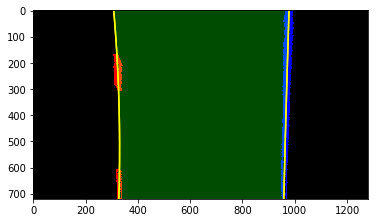

In [12]:
def fit_poly(img_shape, leftx, lefty, rightx, righty):
    ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty **2 + right_fit[1] * ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty

def search_around_poly(binary_warped):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = []
    right_lane_inds = []
    
    win_xleft_low = left_fit[0]*nonzeroy**2 + left_fit[1]*nonzeroy + left_fit[2] - margin
    win_xleft_high = left_fit[0]*nonzeroy**2 + left_fit[1]*nonzeroy + left_fit[2] + margin
    win_xright_low = right_fit[0]*nonzeroy**2 + right_fit[1]*nonzeroy + right_fit[2] - margin
    win_xright_high = right_fit[0]*nonzeroy**2 + right_fit[1]*nonzeroy + right_fit[2] + margin
    
    good_left_inds = ((nonzerox > win_xleft_low) & (nonzerox < win_xleft_high))
    good_right_inds = ((nonzerox > win_xright_low) & (nonzerox < win_xright_high))
    
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty, out_img = fit_polynomial(binary_warped)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    # Generate a polygon to highlight the lane line area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    right_line = np.array([np.flipud(np.transpose(np.vstack([right_fitx, 
                              ploty])))])
    left_line_pts = np.hstack((left_line, right_line))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return result

# Run image through the pipeline
# Note that in your project, you'll also want to feed in the previous fits
result = search_around_poly(warped_image)

# View your output
plt.imshow(result)

In [13]:
def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    `vertices` should be a numpy array of integer points.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

def weighted_img(img, initial_img, α=0.8, β=1., γ=0.):
    """
    `initial_img` should be the image before any processing.
    
    The result image is computed as follows:
    
    initial_img * α + img * β + γ
    NOTE: initial_img and img must be the same shape!
    """
    return cv2.addWeighted(initial_img, α, img, β, γ)

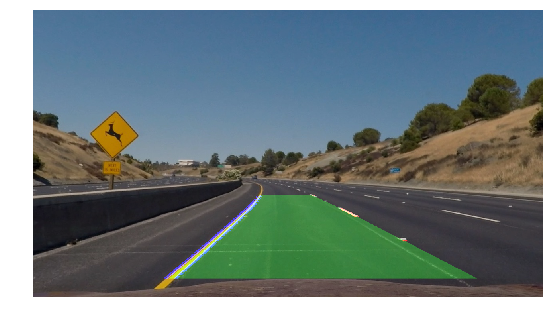

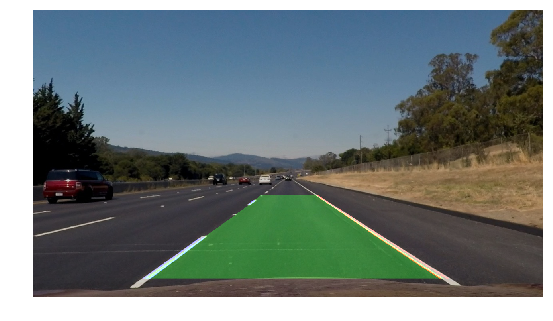

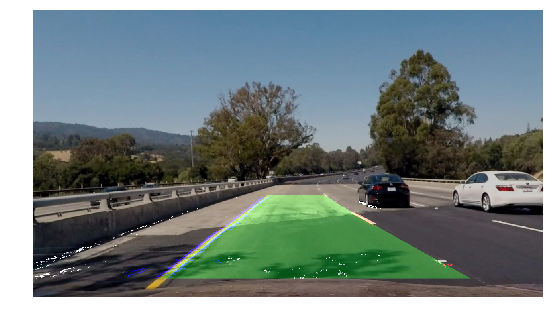

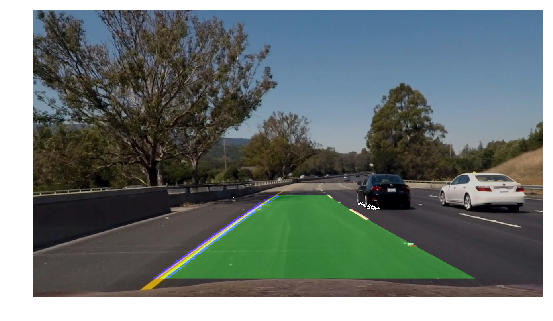

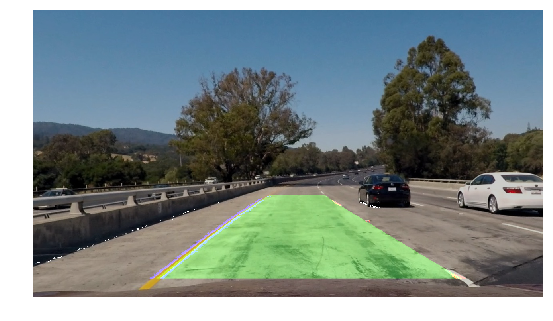

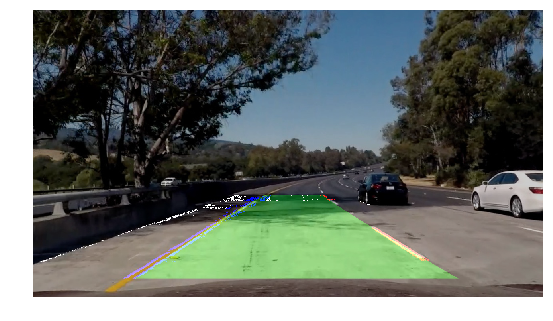

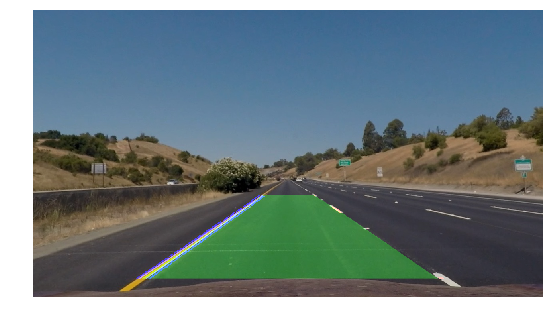

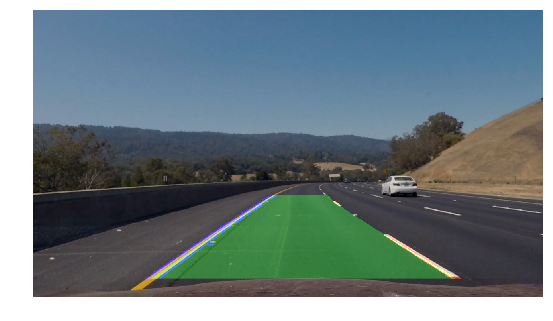

In [14]:
import matplotlib.gridspec as gridspec
files = glob.glob('test_images/*.jpg')

#for file in files:
for idx, file in enumerate(images):
    #img = mpimg.imread("../test_images/"+file)
    plt.figure(figsize=(24, 9))
    gridspec.GridSpec(5, 4)
    img = cv2.imread(file)
    
    imshape = img.shape
    undistorted = cal_undistort(img, objpoints, imgpoints)
    binary = pipeline(undistorted)
    warped_im, M, Minv= warp(binary)
    binary_warped = warped_im
    #left_fitx, right_fitx, ploty, result = fit_polynomial(binary_warped)
    result = search_around_poly(binary_warped)
    out_img_warped = cv2.warpPerspective(result, Minv, (imshape[1], imshape[0]), flags=cv2.INTER_LINEAR)
    
    result = weighted_img(out_img_warped, img, α=0.8, β=1., γ=0.)
        
    cv2.imwrite("output_images/output_"+str(idx)+'.jpg', result)
        
    r, g, b = cv2.split(result)
    result= cv2.merge((b, g, r))
    #plt.imshow(result)
    
    plt.subplot2grid((5, 4), (2, 2), colspan=3, rowspan=3)
    plt.imshow(result)
    plt.axis('off')
    plt.show()

left curverature:  4255.99862268 m, right curvature:  5348.23742579 m


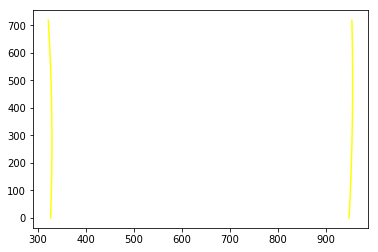

In [17]:
def measure_curvature_real(binary_warped):
    '''
    Calculates the curvature of polynomial functions in meters.
    '''
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    #ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    
    #leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)
    leftx, rightx, ploty, out_img = fit_polynomial(binary_warped)
    
    #leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
    #rightx = rightx[::-1]  # Reverse to match top-to-bottom in y
    
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    ##### TO-DO: Implement the calculation of R_curve (radius of curvature) #####
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    return left_curverad, right_curverad

image = mpimg.imread('test_images/straight_lines1.jpg')

undistorted = cal_undistort(image, objpoints, imgpoints)
undistorted_image = pipeline(undistorted)
warped_image, M, Minv = warp(undistorted_image)

# Calculate the radius of curvature in meters for both lane lines
left_curverad, right_curverad = measure_curvature_real(warped_image)

print('left curverature: ', left_curverad, 'm, right curvature: ', right_curverad, 'm')

In [ ]:
def offset(binary_warped):
    left_fitx, right_fitx, ploty, out_img = fit_polynomial(binary_warped)
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    camera_center = (left_fitx[-1] + right_fitx[-1])/2
    center_diff = (camera_center - binary_warped.shape[1]/2) * xm_per_pix
    side_pos = 'left'
    if center_diff <= 0:
        side_pos = 'right'
    
    return center_diff, side_pos

In [ ]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image where lines are drawn on lanes)
    imshape = image.shape
    vertices = np.array([[(0.12 * imshape[1], 0.935 * imshape[0]),
                          (0.46 * imshape[1],0.62 * imshape[0]), 
                          (0.54 * imshape[1],0.62 * imshape[0]), 
                          (0.88 *imshape[1],0.935 * imshape[0])]], dtype=np.int32)
    
    undistorted = cal_undistort(image, objpoints, imgpoints)
    masked_image = region_of_interest(undistorted, vertices)
    binary = pipeline(masked_image)
    warped_im, M, Minv= warp(binary)
    binary_warped = warped_im
   
    result = search_around_poly(binary_warped)
    
    out_img_warped = cv2.warpPerspective(result, Minv, (imshape[1], imshape[0]), flags=cv2.INTER_LINEAR)
    
    #masked_image = region_of_interest(out_img_warped, vertices)
    result = weighted_img(out_img_warped, image, α=0.8, β=1., γ=0.)

    left_curverad, right_curverad = measure_curvature_real(binary_warped)
    avg_curverad = (left_curverad + right_curverad)/2
    
    center_diff, side_pos = offset(binary_warped)
    
    cv2.putText(result, 'Radius of Curvature =' + str(round(avg_curverad, 3)) + '(m)', (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
    cv2.putText(result, 'Vehicle is ' + str(abs(round(center_diff, 3))) + 'm ' + side_pos + ' of center', (50, 100), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
    
    return result

In [ ]:
project_video_output = 'project_video_output.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
clip1 = VideoFileClip("project_video.mp4").subclip(40,45)
#clip1 = VideoFileClip("project_video.mp4")
project_video_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time project_video_clip.write_videofile(project_video_output, audio=False)

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_video_output))

In [ ]:
#project_video_output = '../test_videos_output/solidWhiteRight.mp4'
challenge_video_output = 'challenge_video_output.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
clip1 = VideoFileClip("challenge_video.mp4").subclip(0,6)
#clip1 = VideoFileClip("challenge_video.mp4")
project_video_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time project_video_clip.write_videofile(challenge_video_output, audio=False)

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_video_output))

In [ ]:
#project_video_output = '../test_videos_output/solidWhiteRight.mp4'
harder_challenge_video_output = 'harder_challenge_video_output.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
clip1 = VideoFileClip("harder_challenge_video.mp4").subclip(0,23)
#clip1 = VideoFileClip("harder_challenge_video.mp4")
project_video_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time project_video_clip.write_videofile(harder_challenge_video_output, audio=False)

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(harder_challenge_video_output))